<a href="https://colab.research.google.com/github/gaydever228/ML_MIPT2/blob/main/HW2.1/task4.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Козлов Сергей Андреевич**, Б05-907

# Задача 4. Вариационный автокодировщик

##импорты

In [ ]:
from copy import deepcopy

import matplotlib.pyplot as plt
from matplotlib.image import imread
from mpl_toolkits import mplot3d
from matplotlib import gridspec
from PIL import Image
import io
import os
from urllib.request import urlopen
from skimage.segmentation import mark_boundaries
from sklearn.model_selection import ParameterGrid
from tqdm.notebook import tqdm
import numpy as np
import requests
import pandas as pd
from scipy.stats import norm
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report

from torch.utils.data import DataLoader, BatchSampler, RandomSampler, Dataset, TensorDataset
from torchvision import datasets, transforms
import torch
from torch.utils.tensorboard import SummaryWriter
from torch import optim
import torch.nn as nn
from nltk.tokenize import RegexpTokenizer

from torch.nn import functional as F
from torch.nn.utils.rnn import pad_sequence

import pickle

from itertools import islice, chain
from sklearn.model_selection import train_test_split
from collections import Counter


import random
from torch.optim import lr_scheduler

In [ ]:
import warnings
warnings.filterwarnings("ignore")

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

##датасет

In [ ]:
def generate_data(dataset_size, dim, n_clusters=5):
    X = []
    mus = []
    sigmas = []
    for _ in range(n_clusters):
        locs = np.random.uniform(-5, 5, dim) #среднее
        scales = np.random.uniform(1, 2, dim) #ковариация
        cluster = np.random.multivariate_normal(mean=locs, cov=np.diag(scales), size=dataset_size)
        mus.append(locs)
        sigmas.append(scales)
        X.append(cluster)

    X = np.stack(X).reshape(-1, dim)
    return X, mus, sigmas

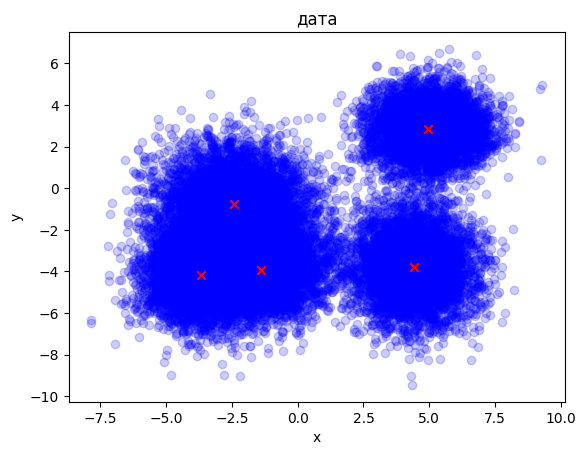

In [ ]:
dataset_size = 5000
dim = 2
n_clusters = 5

X, mus, sigmas = generate_data(dataset_size, dim, n_clusters)

x, y = X.T
plt.scatter(x, y, c='blue', alpha=0.2)
for mu in mus:
    plt.scatter(mu[0], mu[1], c='red', marker='x')
plt.xlabel('x')
plt.ylabel('y')
plt.title('дата')
plt.show()

##модель

In [ ]:
class VAE(nn.Module):
    @property
    def device(self):
        return next(self.parameters()).device
    def __init__(self,
                 in_channels,
                 latent_dim,
                 n_layers):
        super().__init__()

        self.latent_dim = latent_dim

        modules = []       
        hidden_dims = [10 * 2**i for i in range( n_layers)]
        
        tmp = in_channels
        for h_dim in hidden_dims:
            modules.append(
                nn.Sequential(
                    nn.Linear(tmp, h_dim), 
                    nn.BatchNorm1d(h_dim), 
                    nn.LeakyReLU())
            )
            tmp = h_dim

        self.encoder = nn.Sequential(*modules)
        self.fc_mu = nn.Linear(hidden_dims[-1], latent_dim)
        self.fc_var = nn.Linear(hidden_dims[-1], latent_dim)

        modules = []
        self.decoder_input = nn.Linear(latent_dim, hidden_dims[-1])
        hidden_dims.reverse()

        for i in range(len(hidden_dims) - 1):
            modules.append(
                nn.Sequential(
                    nn.Linear(hidden_dims[i], hidden_dims[i + 1]),
                    nn.BatchNorm1d(hidden_dims[i + 1]),
                    nn.LeakyReLU())
            )

        self.decoder = nn.Sequential(*modules)

        self.final_layer = nn.Sequential(
                            nn.Linear(hidden_dims[-1], hidden_dims[-1]),
                            nn.BatchNorm1d(hidden_dims[-1]),
                            nn.LeakyReLU(),
                            nn.Linear(hidden_dims[-1], in_channels))

    def encode(self, input):
        """
        Encodes the input by passing through the encoder network
        and returns the latent codes.
        :param input: (Tensor) Input tensor to encoder [N x C x H x W]
        :return: (Tensor) List of latent codes
        """
        result = self.encoder(input)
        result = torch.flatten(result, start_dim=1)

        # Split the result into mu and var components
        # of the latent Gaussian distribution
        mu = self.fc_mu(result)
        log_var = self.fc_var(result)

        return [mu, log_var]

    def decode(self, z):
        """
        Maps the given latent codes
        onto the image space.
        :param z: (Tensor) [B x D]
        :return: (Tensor) [B x C x H x W]
        """
        result = self.decoder_input(z)
        result = self.decoder(result)
        result = self.final_layer(result)
        return result

    def reparameterize(self, mu, logvar):
        """
        Reparameterization trick to sample from N(mu, var) from
        N(0,1).
        :param mu: (Tensor) Mean of the latent Gaussian [B x D]
        :param logvar: (Tensor) Standard deviation of the latent Gaussian [B x D]
        :return: (Tensor) [B x D]
        """
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return eps * std + mu

    def forward(self, input, **kwargs):
        mu, log_var = self.encode(input)
        z = self.reparameterize(mu, log_var)
        return  [self.decode(z), input, mu, log_var]

    def loss(self, *args, **kwargs):
        """
        Computes the VAE loss function.
        KL(N(\mu, \sigma), N(0, 1)) = \log \frac{1}{\sigma} + \frac{\sigma^2 + \mu^2}{2} - \frac{1}{2}
        :param args:
        :param kwargs:
        :return:
        """
        recons = args[0]
        input = args[1]
        mu = args[2]
        log_var = args[3]

        recons_loss =F.mse_loss(recons, input) 
        kld_loss = torch.mean(-0.5 * torch.sum(1 + log_var - mu ** 2 - log_var.exp(), dim = 1), dim = 0)

        loss = recons_loss + kld_loss
        return loss 

    def sample(self,
               num_samples:int, **kwargs):
        """
        Samples from the latent space and return the corresponding
        image space map.
        :param num_samples: (Int) Number of samples
        :param current_device: (Int) Device to run the model
        :return: (Tensor)
        """
        z = torch.randn(num_samples,
                        self.latent_dim)

        z = z.to(self.device)

        samples = self.decode(z)
        return samples

    def generate(self, x, **kwargs):
        """
        Given an input image x, returns the reconstructed image
        :param x: (Tensor) [B x C x H x W]
        :return: (Tensor) [B x C x H x W]
        """

        return self.forward(x)[0]

##функции для обучения

In [ ]:
def trainer(count_of_epoch, 
            batch_size, 
            train_dataset,
            model, 
            loss_function,
            optimizer,
            lr = 0.001,
            writer = None,
            mode = 'reg',
            BPE = 128
           ):

  optima = optimizer(model.parameters(), lr=lr)
  scheduler = torch.optim.lr_scheduler.ExponentialLR(optima, gamma=0.95)
  iterations = tqdm(range(count_of_epoch), desc='epoch')

  iterations.set_postfix({'train epoch loss': np.nan})
  for it in iterations:
    if mode == 'reg':
      train_generator = DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)
    else:
      generator = DataLoader(
          dataset=train_dataset, batch_sampler=BatchSampler(
            RandomSampler(
              data_source=train_dataset,
              replacement=True,
              num_samples=64*BPE), 
          batch_size=64, 
          drop_last=True))

    epoch_loss = train_epoch(train_generator=train_generator, 
                model=model, 
                loss_function=loss_function, 
                optimizer=optima,
                scheduler=scheduler,
                writer=writer,
                epoch=it)
    if scheduler is not None:
      scheduler.step()
    iterations.set_postfix({'train epoch loss': epoch_loss})
def train_on_batch(model, x_batch, optimizer, loss_function):
    model.train()
    optimizer.zero_grad()
    
    results = model(x_batch.to(model.device))
    loss = model.loss(*results)
    loss.backward()

    optimizer.step()
    return loss.cpu().item()

def train_epoch(train_generator, model, loss_function, optimizer, scheduler=None, writer=None, epoch=None):
    epoch_loss = 0
    total = 0
    step = len(train_generator) * epoch
    loop = tqdm(train_generator, leave = False, total = len(train_generator))
    for batch_of_x in loop:
        batch_loss = train_on_batch(model, batch_of_x[0], optimizer, loss_function)

            
        loss = batch_loss*len(batch_of_x)
        writer.add_scalar('LOSS/train', loss, step)
        epoch_loss += loss
        total += len(batch_of_x)
        loop.set_description(f'{epoch}. Loss: {loss:.4f}')
        step += 1
    scheduler.step()
    
    return epoch_loss/total

In [ ]:
def tester(model, ds_test, config, writer):
  model.eval()
  test_generator = DataLoader(dataset=ds_test, batch_size=64, shuffle=True)
  total = 0
  losses = 0
  step = 0
  for batch_of_x in tqdm(test_generator, leave = False, total = len(test_generator)):
    results = model(batch_of_x[0].to(model.device))
    ls = model.loss(*results).item()
    losses += ls
    #print(model.loss(*results).item())
    total += len(batch_of_x)
    step += len(batch_of_x)
    writer.add_scalar('LOSS/test', ls, step)
  loss = losses/total
  
  if config['in_channels'] == 2:
    print("Picture")
    distr = model.sample(1000)
    x,y = np.array(distr.detach().cpu()).T
    plt.figure(figsize=(5, 4), dpi=100)
    decoding = model.generate(distr).detach().cpu()
    plt.scatter(x, y, c='blue', alpha=0.25, label='Initial data')
    plt.scatter(decoding[:, 0], decoding[:, 1], c = 'red', alpha = 0.1, label='Generated data')
    plt.axis('equal')
    plt.xlabel('x')
    plt.ylabel('y')
    plt.title('everithin')
    plt.legend()
    plt.show()

    writer.add_figure('Samples', plt.gcf())



  return loss

##анализ

In [ ]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
def serious_test(config, dir, exp_dir = '', BPE = 512, mode = 'reg'):
    
  loss_function = torch.nn.CrossEntropyLoss()
  optimizer = torch.optim.Adam
  print(str(config))

  X, mus, sigmas = generate_data(dataset_size=20000, dim=config['in_channels'])
  ds_train = TensorDataset(torch.from_numpy(np.array(X[:15000, :], dtype='float32')))
  ds_test = TensorDataset(torch.from_numpy(np.array(X[15000:, :], dtype='float32')))
  model = VAE(**config).to(device)
  writer = SummaryWriter(log_dir = dir + exp_dir)

  
  scheduler = lr_scheduler.StepLR(optimizer(model.parameters(), lr=0.001), step_size=1, gamma=0.5)
  

  trainer(count_of_epoch=8,
            batch_size=128,
            train_dataset=ds_train,
            model=model, 
            loss_function=model.loss,
            optimizer = optimizer,
            lr = 0.001,
            writer = writer)

  

  loss1 = tester(model, ds_test, config, writer)
  print(loss1)
  writer.add_hparams(config, {'Test/loss': loss1})
  writer.flush()

  torch.cuda.empty_cache()
  return loss1

In [ ]:
best_config = {
    'in_channels': 2,
    'latent_dim': 4,
    'n_layers': 3
}
loss_best = 1000
work_dir = 'drive/MyDrive/MIPT/MLV/pt.2/t4'

{'in_channels': 2, 'latent_dim': 4, 'n_layers': 3}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

Picture


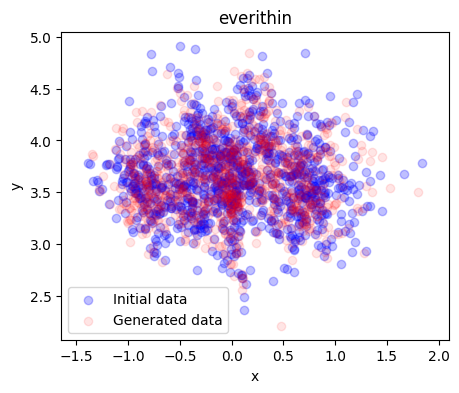

23.0392695398955


In [ ]:
loss_best = serious_test(best_config, work_dir, exp_dir = '/check')

##1)зависимость от размерности скрытого подпространства

{'in_channels': 2, 'latent_dim': 2, 'n_layers': 3}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

Picture


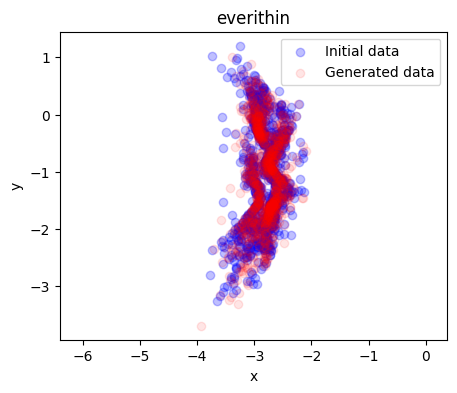

9.24888800749481
{'in_channels': 2, 'latent_dim': 4, 'n_layers': 3}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

Picture


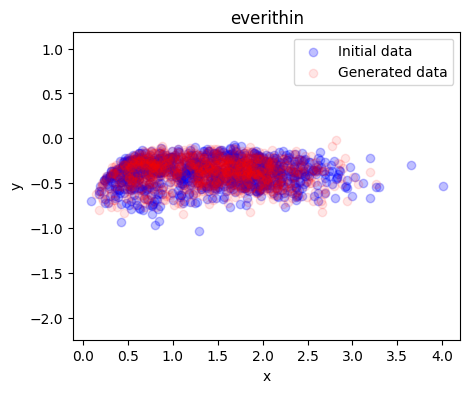

7.96552070627722
{'in_channels': 2, 'latent_dim': 8, 'n_layers': 3}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

Picture


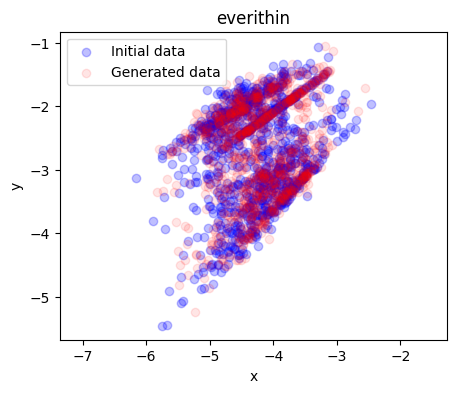

7.947740593200523
{'in_channels': 2, 'latent_dim': 16, 'n_layers': 3}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

Picture


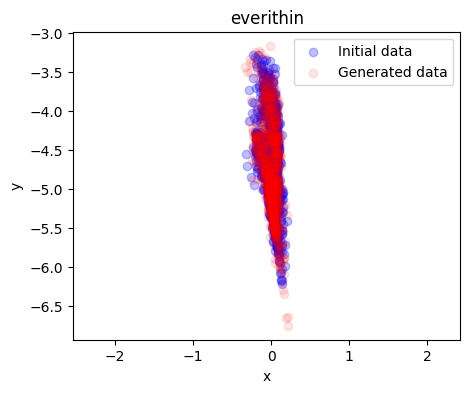

20.23278424253672


In [ ]:
config = deepcopy(best_config)
for e in [2,4,8,16]:
  config['latent_dim'] = e
  loss = serious_test(config, work_dir, exp_dir = '/latent_dim/' + str(e))
  if loss < loss_best:
    loss_best = loss
    best_config = deepcopy(config)

In [ ]:
print(best_config, loss_best)

{'in_channels': 2, 'latent_dim': 8, 'n_layers': 3} 7.947740593200523


In [ ]:
%tensorboard --logdir drive/MyDrive/MIPT/MLV/pt.2/t4/latent_dim --port 6007

Reusing TensorBoard on port 6007 (pid 1693), started 0:11:12 ago. (Use '!kill 1693' to kill it.)

<IPython.core.display.Javascript object>

##2)зависимость от размерности исходного пространства

{'in_channels': 2, 'latent_dim': 8, 'n_layers': 3}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

Picture


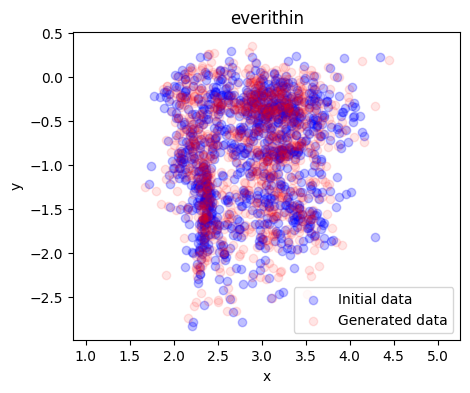

17.234204625258148
{'in_channels': 4, 'latent_dim': 8, 'n_layers': 3}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

16.81053983976825
{'in_channels': 8, 'latent_dim': 8, 'n_layers': 3}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

19.897876118070833
{'in_channels': 16, 'latent_dim': 8, 'n_layers': 3}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

18.862176824817986


In [ ]:
config = deepcopy(best_config)
for e in [2,4,8,16]:
  config['in_channels'] = e
  loss = serious_test(config, work_dir, exp_dir = '/input_dim/' + str(e))
  if loss < loss_best:
    loss_best = loss
    best_config = deepcopy(config)

In [ ]:
print(best_config, loss_best)

{'in_channels': 2, 'latent_dim': 8, 'n_layers': 3} 7.947740593200523


In [ ]:
%tensorboard --logdir drive/MyDrive/MIPT/MLV/pt.2/t4/input_dim --port 6006

Reusing TensorBoard on port 6006 (pid 1945), started 0:11:11 ago. (Use '!kill 1945' to kill it.)

<IPython.core.display.Javascript object>

##3)серия тестов с различными значениями размерностей, но с сохранением их соотношения

{'in_channels': 1, 'latent_dim': 2, 'n_layers': 3}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

4.821985404952475
{'in_channels': 2, 'latent_dim': 4, 'n_layers': 3}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

Picture


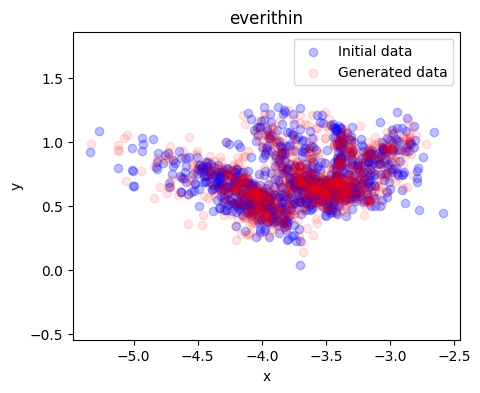

19.370388345309358
{'in_channels': 4, 'latent_dim': 8, 'n_layers': 3}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

17.244795367267457
{'in_channels': 8, 'latent_dim': 16, 'n_layers': 3}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

13.86644859184799


In [ ]:
config = deepcopy(best_config)
for e in [1,2,4,8]:
  config['in_channels'] = e
  config['latent_dim'] = e*2
  loss = serious_test(config, work_dir, exp_dir = '/input_dim_latent_dim/' + str(e)+'_'+str(2*e))
  if loss < loss_best:
    loss_best = loss
    best_config = deepcopy(config)

In [ ]:
print(best_config, loss_best)

{'in_channels': 1, 'latent_dim': 2, 'n_layers': 3} 4.821985404952475


In [ ]:
%tensorboard --logdir drive/MyDrive/MIPT/MLV/pt.2/t4/input_dim_latent_dim --port 6012

Reusing TensorBoard on port 6012 (pid 3199), started 0:07:36 ago. (Use '!kill 3199' to kill it.)

<IPython.core.display.Javascript object>

##4)зависимость от числа слоёв

In [ ]:
config = deepcopy(best_config)
for e in [2,4,8]:
  config['n_layers'] = e
  loss = serious_test(config, work_dir, exp_dir = '/n_layers/' + str(e))
  if loss < loss_best:
    loss_best = loss
    best_config = deepcopy(config)

{'in_channels': 1, 'latent_dim': 2, 'n_layers': 2}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

13.974382159403161
{'in_channels': 1, 'latent_dim': 2, 'n_layers': 4}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

5.523769043907355
{'in_channels': 1, 'latent_dim': 2, 'n_layers': 8}


epoch:   0%|          | 0/8 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/118 [00:00<?, ?it/s]

  0%|          | 0/1329 [00:00<?, ?it/s]

7.18123681460941


In [ ]:
print(best_config, loss_best)

{'in_channels': 1, 'latent_dim': 2, 'n_layers': 3} 4.821985404952475


In [ ]:
%tensorboard --logdir drive/MyDrive/MIPT/MLV/pt.2/t4/n_layers --port 60013

Reusing TensorBoard on port 60013 (pid 3417), started 0:07:39 ago. (Use '!kill 3417' to kill it.)

<IPython.core.display.Javascript object>

#выводы
Модель неплохо имитирует начальное распределение при любых параметрах

1) наилучшая размерность скрытого подпространства получилась 4, ожидалось, что с большой размерностью модель будет обучаться лучше, но, хоть большая размерность сходится на трейне примерно туда же, на тесте такая модель демонстрирует худшие показатели

2) тут тоже всё неоднозначно, большая размерность исходного пространства ничего особо не меняет, но всё же на тесте маленькая и средняя размерности работают лучше

3) всё-таки качество модели зависит не столько от соотношения размерностей, сколько от их абсолютных величин, так как при сохранении одинакового соотношения, с ростом размерностей качество модели падало

4) маленькое число слоёв ожидаемо даёт наихудший результат, но при этом лучше всего, когда слоя 4, так что сложная модель также даёт не лучший результат, так что, тут важна золотая середина

